# Inference on YOLOv8 using Slicing Aided Hyper Inference Technique

In [3]:
# Check current working directory
import os
os.getcwd()

'c:\\Users\\w10\\Desktop\\Python-env\\first_train'

In [1]:
import torch

torch.cuda.empty_cache()
print(torch.cuda.get_device_name(0))

NVIDIA GeForce GTX 750 Ti


In [2]:
!pip cache purge

Files removed: 294


In [1]:
%pip install -U ultralytics sahi numpy opencv-python


     ---------------------------------------- 0.0/61.0 kB ? eta -:--:--
     ------ --------------------------------- 10.2/61.0 kB ? eta -:--:--
     ------------ ------------------------- 20.5/61.0 kB 222.6 kB/s eta 0:00:01
     ------------------- ------------------ 30.7/61.0 kB 220.2 kB/s eta 0:00:01
     ------------------------------- ------ 51.2/61.0 kB 292.6 kB/s eta 0:00:01
     -------------------------------------- 61.0/61.0 kB 325.6 kB/s eta 0:00:00
   ---------------------------------------- 0.0/15.8 MB ? eta -:--:--
   ---------------------------------------- 0.1/15.8 MB 1.7 MB/s eta 0:00:10
   ---------------------------------------- 0.2/15.8 MB 2.2 MB/s eta 0:00:08
    --------------------------------------- 0.3/15.8 MB 2.5 MB/s eta 0:00:07
   - -------------------------------------- 0.4/15.8 MB 2.4 MB/s eta 0:00:07
   - -------------------------------------- 0.6/15.8 MB 2.7 MB/s eta 0:00:06
   - -------------------------------------- 0.7/15.8 MB 2.8 MB/s eta 0:00:06
  

## In this inference notebook, we will be using a pretrained YOLOv8-S model, as the Object Detector.

This cell imports the model functions and classes from the SAHI directory.

In [2]:
# Import required functions and classes
from sahi import AutoDetectionModel
from sahi.utils.cv import read_image
from sahi.utils.file import download_from_url
from sahi.predict import get_prediction, get_sliced_prediction, predict
from sahi.prediction import visualize_object_predictions
from IPython.display import Image
import glob
import cv2
from numpy import asarray

This cell is to call our model and test_images to perform inference.

In [3]:
# Download YOLOv8-S model to 'models/yolov8s.pt'
model_path = (
    "C:/Users/w10/Desktop/Python-env/first_train/runs/detect/train/weights/best.pt"
)
image_paths = glob.glob(
    "C:/Users/w10/Desktop/test/*.*"
)

# Perform Inference on the model (without and with SAHI)

In this cell, a detection model has been initialized by defining the model weight path, and other necessary parameters such as confidence_threshold and device.

**NOTE:** If you have an Nvidia GPU for CUDA acceleration, then set `device='cuda:0'` otherwise, leave it as `device='cpu'`.

In [4]:
detection_model = AutoDetectionModel.from_pretrained(
    model_type='yolov8',
    model_path=model_path,
    confidence_threshold=0.4,
    device="cuda:0", # or 'cpu'
)
detection_model.model.agnostic = True

ImportError: cannot import name '_c_internal_utils' from partially initialized module 'matplotlib' (most likely due to a circular import) (c:\Users\w10\anaconda3\envs\Yolo-env\Lib\site-packages\matplotlib\__init__.py)

## Perform Inference and Visualize (without SAHI)

In [30]:
# Example 1
result = get_prediction(
    "C:/Users/w10/Desktop/Python-env/first_train/Dataset/images/val/holy_images (173).jpg",
    detection_model,
)

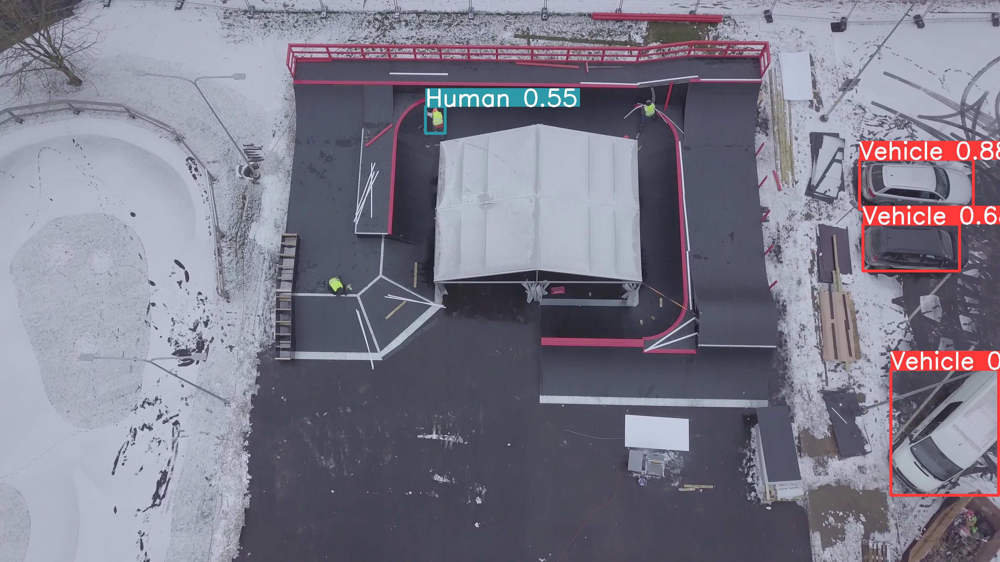

In [31]:
# Example 1
result.export_visuals(export_dir="sahi_tests/")

Image("sahi_tests/prediction_visual.png")

In [32]:
# Example 2
result = get_prediction(
    "C:/Users/w10/Desktop/Python-env/first_train/Dataset/images/val/tekno-4 (50).jpg",
    detection_model,
)

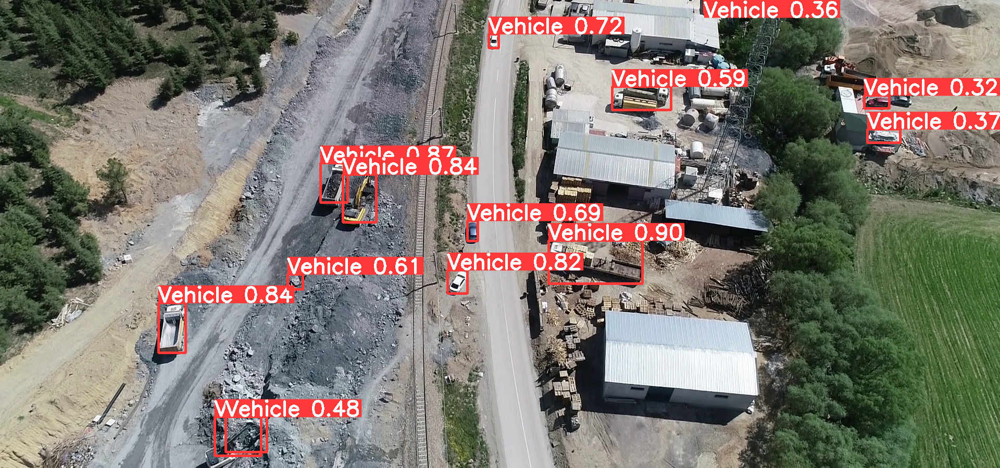

In [33]:
# Example 2
result.export_visuals(export_dir="sahi_tests/")

Image("sahi_tests/prediction_visual.png")

In [34]:
# Example 3
result = get_prediction(
    "C:/Users/w10/Desktop/Python-env/first_train/Dataset/images/val/frame_006120.jpg",
    detection_model,
)

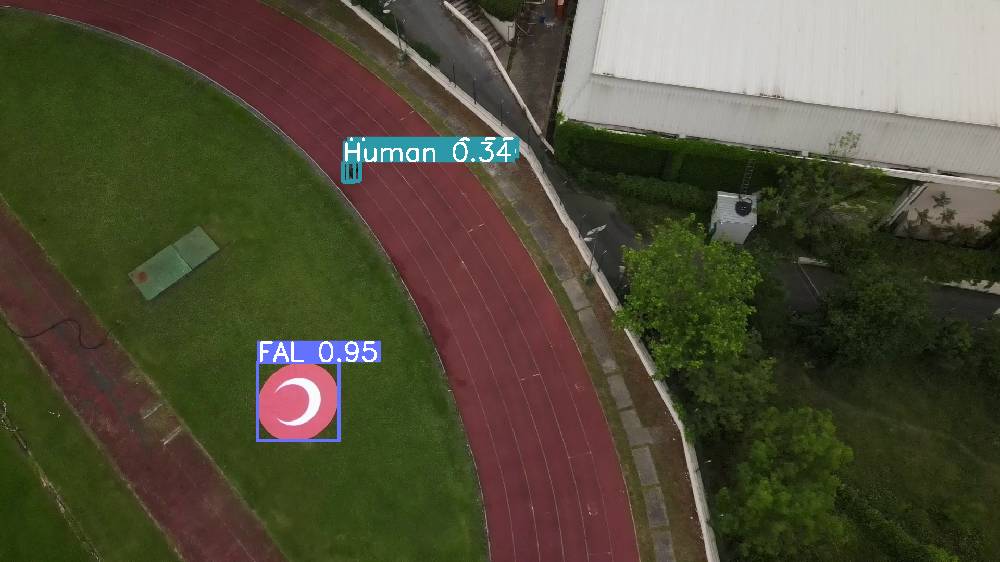

In [35]:
# Example 3
result.export_visuals(export_dir="sahi_tests/")

Image("sahi_tests/prediction_visual.png")

## Perform Sliced Inference (with SAHI)

**NOTE:** To perform sliced prediction we need to specify slice parameters.

Experiement with different `slice_height` and `slice_width`, `overlap_height_ratio`, and `overlap_width_ratio` parameters. More compute is required for more number of slices.

In [49]:
# Example 1
result = get_sliced_prediction(
    "C:/Users/w10/Desktop/Python-env/first_train/Dataset/images/val/frame_006120.jpg",
    detection_model,
    slice_height=256,
    slice_width=256,
    overlap_height_ratio=0.2,
    overlap_width_ratio=0.2,
    postprocess_class_agnostic=True,  # ensure that agnostic_nms is set to true in your YOLOv8 args.yaml file.
)

Performing prediction on 60 slices.


## Visualize predicted bounding boxes over the same image (with SAHI)

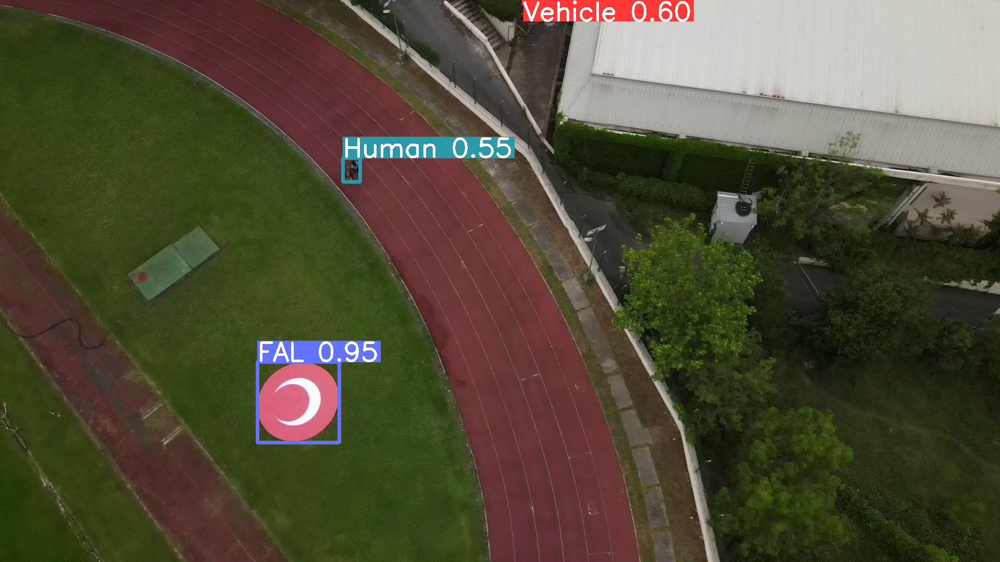

In [50]:
img = cv2.imread(
    "C:/Users/w10/Desktop/Python-env/first_train/Dataset/images/val/frame_006120.jpg",
    cv2.IMREAD_UNCHANGED,
)
img_converted = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
numpydata = asarray(img_converted)
visualize_object_predictions(
    numpydata, 
    object_prediction_list = result.object_prediction_list,
    hide_labels = False,
    output_dir='sahi_tests/',
    file_name = 'result',
    export_format = 'png'
)
Image('sahi_tests/result.png')

In [71]:
# Example 2
result = get_sliced_prediction(
    "C:/Users/w10/Desktop/Python-env/first_train/Dataset/images/val/frame_15_100_20230130143928829585.jpg",
    detection_model,
    slice_height=512,
    slice_width=512,
    overlap_height_ratio=0.1,
    overlap_width_ratio=0.1,
    postprocess_class_agnostic=False
)

Performing prediction on 45 slices.


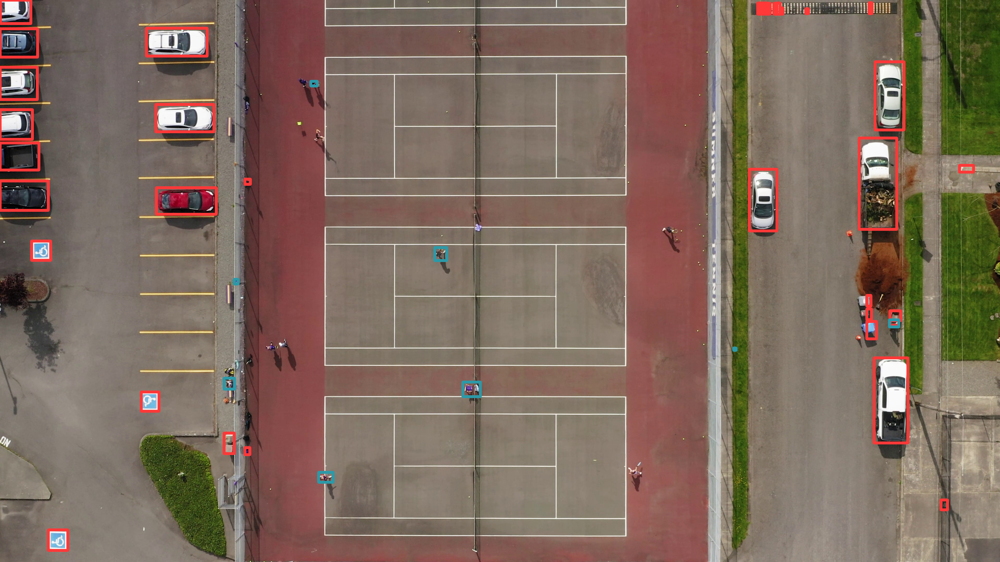

In [72]:
img = cv2.imread(
    "C:/Users/w10/Desktop/Python-env/first_train/Dataset/images/val/frame_15_100_20230130143928829585.jpg",
    cv2.IMREAD_UNCHANGED,
)
img_converted = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
numpydata = asarray(img_converted)
visualize_object_predictions(
    numpydata, 
    object_prediction_list = result.object_prediction_list,
    hide_labels = True, 
    output_dir='sahi_tests/',
    file_name = 'result',
    export_format = 'png'
)
Image('sahi_tests/result.png')

In [56]:
# Example 3
result = get_sliced_prediction(
    "demo_data/cars.jpg",
    detection_model,
    slice_height = 256,
    slice_width = 256,
    overlap_height_ratio = 0.9,
    overlap_width_ratio = 0.9
)

Performing prediction on 390 number of slices.


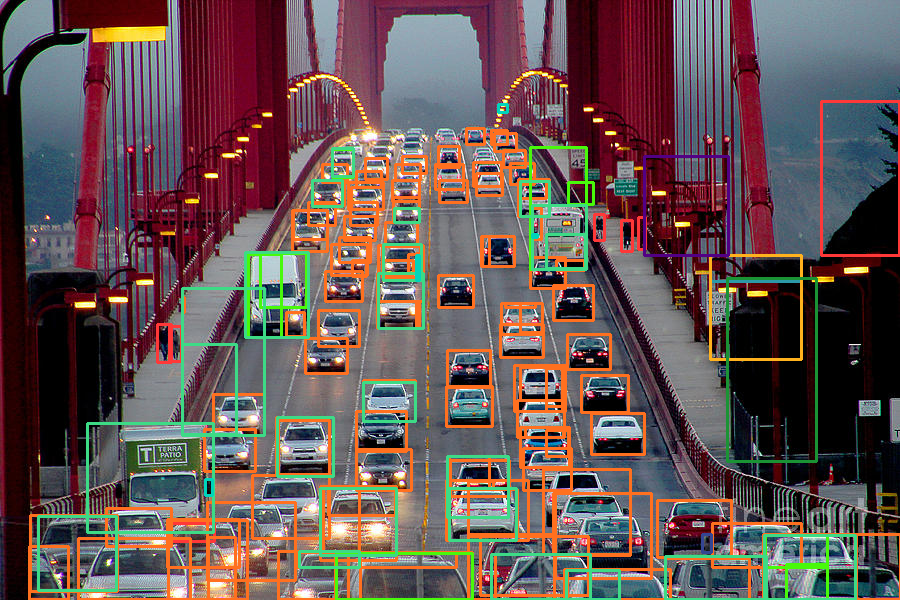

In [57]:
img = cv2.imread("demo_data/cars.jpg", cv2.IMREAD_UNCHANGED)
img_converted = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
numpydata = asarray(img_converted)
visualize_object_predictions(
    numpydata, 
    object_prediction_list = result.object_prediction_list,
    hide_labels = True, 
    output_dir='/content/demo_data',
    file_name = 'result',
    export_format = 'png'
)
Image('demo_data/result.png')

# In this section i wanted to see the slice so that i can udjest some the pixcels

Instantiate a detection model by defining model weight path and other parameters:

In [4]:
detection_model = AutoDetectionModel.from_pretrained(
    model_type="yolov8",
    model_path=model_path,
    confidence_threshold=0.4,
    device="cuda:0",  # or 'cpu'
)
detection_model.model.agnostic = True

In [5]:
for i, image_path in enumerate(image_paths):
    # Get the sliced prediction for the current image
    # waxaan kusoo daray slice_image_result kasoo ah returnka get_sliced
    result, slice_image_result = get_sliced_prediction(
        image_path,  # Corrected: use the actual image path
        detection_model,
        slice_height=512,
        slice_width=512,
        overlap_height_ratio=0.25,
        overlap_width_ratio=0.25,
        postprocess_class_agnostic=True,
    ) # type: ignore
    # Export the visuals for the current image
    # result.export_visuals(
    # export_dir="C:/Users/w10/Desktop/test/sahi/sliced/",
    # file_name=f"{i}",
    # hide_labels=True,
    # )

Performing prediction on 15 slices.
Performing prediction on 15 slices.
Performing prediction on 15 slices.
Performing prediction on 15 slices.
Performing prediction on 15 slices.
Performing prediction on 15 slices.


In [7]:
for sliced in slice_image_result._sliced_image_list:
    cv2.imshow("slice", sliced.image)
    print(sliced.image.shape, sliced.starting_pixel)
    if cv2.waitKey(0) & 0xFF == ord("q"):
        break

cv2.destroyAllWindows()

(512, 512, 3) [0, 0]
(512, 512, 3) [384, 0]
(512, 512, 3) [768, 0]
(512, 512, 3) [1152, 0]
(512, 512, 3) [1408, 0]
(512, 512, 3) [0, 384]
(512, 512, 3) [384, 384]


In [ ]:
# to see the array from the first image slices
print(slice_image_result._sliced_image_list[0].image)

# To continue training

In [ ]:
!yolo train resume model=/last.pt data=dataset.yaml epochs=100 imgsz=640 batch=8
# Resume an interrupted training
!yolo train resume model=path/to/last.pt